<a href="https://colab.research.google.com/github/ryanczhang7/spotifyproject/blob/master/Spotify_Presentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analysis of Spotify Song Data

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats

In [0]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.feature_extraction import text

In [0]:
pip install pandas-profiling[notebook,html]

In [0]:
from pandas_profiling import ProfileReport

In [0]:
df_personality_sentiment = pd.read_csv(
    "/content/drive/My Drive/df_personality_sentiment.csv")
df_songs = pd.read_csv("/content/drive/My Drive/df_songs.csv")

**I chose pop artists and hiphop artists to get song data for, from the Spotify Web API(using spotipy). I ended up with about 500 pop songs and 500 hiphop songs. I then got "audio features" on all the songs.**

In [0]:
df_songs.head()

,artist,album,name,explicit,key,mode,time_signature,acousticness,danceability,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,genre,duration_s
0,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Black Panther,1,1,1,4,0.6250,0.618,0.582,0.000004,0.2650,-9.454,0.2970,90.035,0.480,57,hiphop,130.613
1,Kendrick Lamar,Black Panther The Album Music From And Inspire...,All The Stars,1,8,1,4,0.0605,0.698,0.633,0.000194,0.0926,-4.946,0.0597,96.924,0.552,78,hiphop,232.186
2,Kendrick Lamar,Black Panther The Album Music From And Inspire...,X,1,2,1,4,0.0201,0.768,0.471,0.000000,0.2680,-8.406,0.2590,131.023,0.405,69,hiphop,267.426
3,Kendrick Lamar,Black Panther The Album Music From And Inspire...,The Ways,1,11,0,4,0.0626,0.727,0.720,0.000001,0.1760,-5.856,0.0488,140.080,0.589,65,hiphop,238.893
4,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Opps,1,1,1,4,0.1520,0.706,0.775,0.000033,0.4160,-6.819,0.3350,127.929,0.847,59,hiphop,180.893


**I web scraped song lyrics for the songs. I could only get lyrics for 830 of the songs. I then used the Google Natural Language API to get sentiment analysis on all of the lyrics. I also used the IBM Watson Cloud API to get personality analysis on all the lyrics. The Personality Insights required text of at least 100 words, so I didn't get data for 10 songs. I call these sentiment and personality features "textual features".**

In [0]:
df_personality_sentiment.head()

,artist,album,name,explicit,genre,chain_lyrics,lyrics,polarity,magnitude,artistic,emotion,imagination,assertive,cheeful,outgoing,modesty,sympathy,fiery,melancholy
0,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Black Panther,1,hiphop,why i go easy \n know why i go easy \n wait \n...,why i go easy know why i go easy wait king of ...,-1.0,1.2,0.999983,0.931594,0.998384,0.095272,0.387043,0.101374,0.421143,0.985013,0.386352,0.921542
1,Kendrick Lamar,Black Panther The Album Music From And Inspire...,All The Stars,1,hiphop,love lets talk about love \n is it anything an...,love lets talk about love is it anything and e...,-1.0,1.3,0.996511,0.986234,0.991554,0.747748,0.986040,0.705842,0.441873,0.842244,0.157679,0.626636
2,Kendrick Lamar,Black Panther The Album Music From And Inspire...,I Am,1,hiphop,everybody put three fingers in the air \n the ...,everybody put three fingers in the air the sky...,-1.0,2.2,0.906971,0.318395,0.994980,0.574279,0.469771,0.320161,0.024560,0.785487,0.582447,0.669157
3,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Big Shot,1,hiphop,wakanda welcome \n big shot hol up wait peanut...,wakanda welcome big shot hol up wait peanut bu...,-1.0,1.3,0.967339,0.229457,0.975867,0.382183,0.880943,0.477181,0.000747,0.270318,0.787414,0.197281
4,Kendrick Lamar,Black Panther The Album Music From And Inspire...,Pray For Me,1,hiphop,im always ready for a war again \n go down tha...,im always ready for a war again go down that r...,-1.0,1.1,0.980110,0.889895,0.977369,0.307116,0.962168,0.668731,0.864149,0.875111,0.464351,0.871338


# Research Question

**Are audio features or textual features better predictors of genre of a song?**

# Exploratory Data Analysis and Visualizations

**Thanks to Simon Brugman and collaborators for their pandas-profiling project on Github, which makes EDA very efficient and clean.**

In [7]:
profile = ProfileReport(df_songs, title='Pandas Profiling Report', 
                        html={'style':{'full_width':True}})

In [8]:
profile.to_notebook_iframe()

**A couple variables have high correlation to each other, which I may not want to include together as features.**

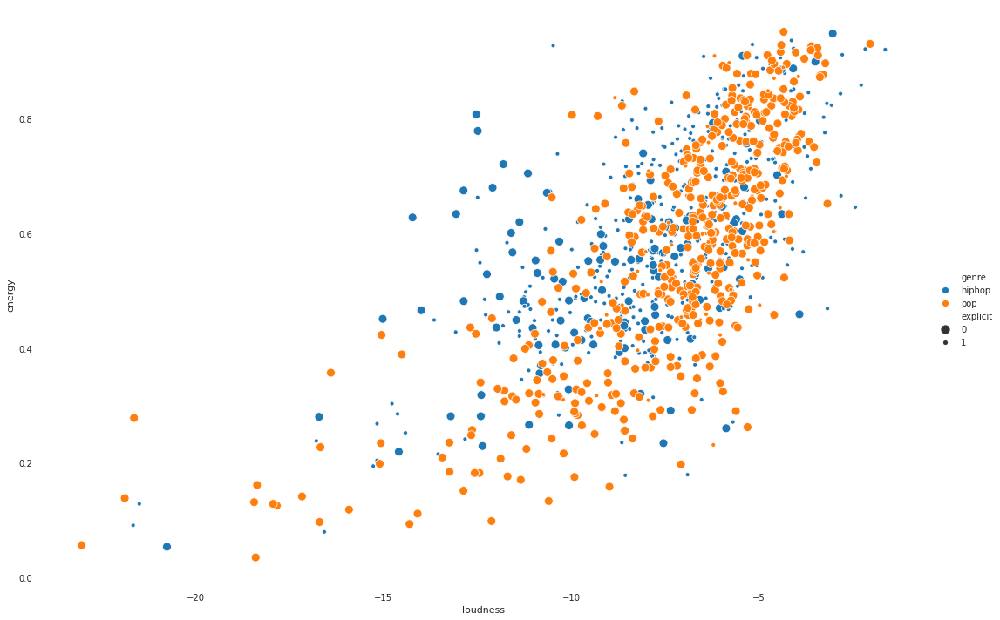

In [9]:
sns.relplot(x="loudness", y="energy", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_songs)

**Visualization of popularity by artist and genre.**

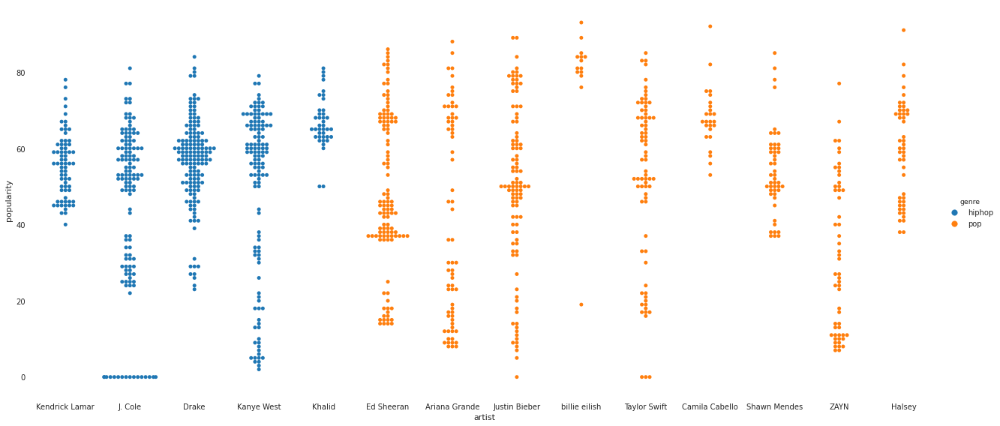

In [11]:
sns.catplot(x="artist", y="popularity", hue = "genre", 
            height = 8, aspect = 2.2, kind= "swarm", data=df_songs)

**Visualization of popularity by explicit and genre. From this I think that explicit will be a good predictor for genre.**

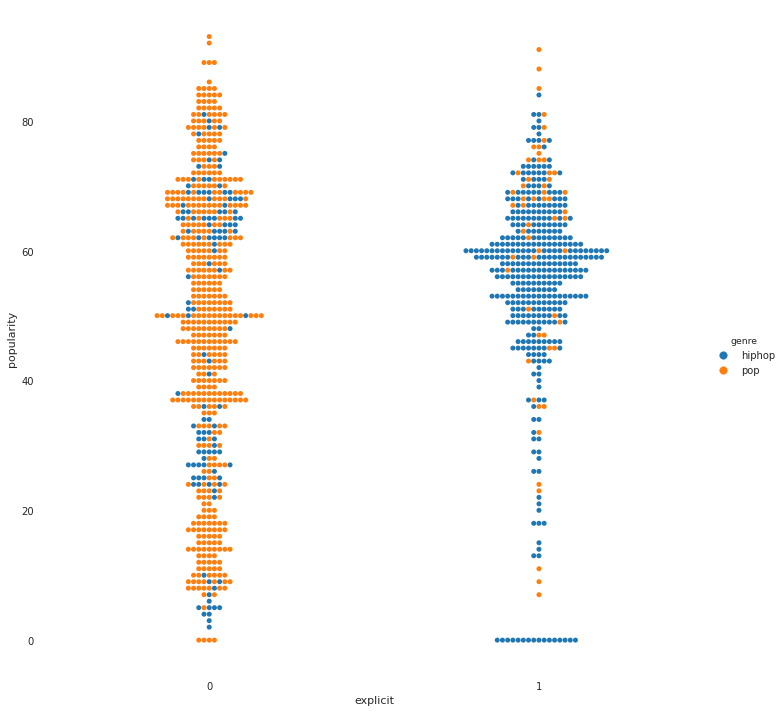

In [13]:
sns.catplot(x="explicit", y="popularity", hue = "genre", 
            height = 10, aspect = 1, kind= "swarm", data=df_songs)

**Now looking at df_personality_sentiment**

In [14]:
profile = ProfileReport(df_personality_sentiment, 
                        title='Pandas Profiling Report', 
                        html={'style':{'full_width':True}})

In [15]:
profile.to_notebook_iframe()

**A couple features have high correlation again**

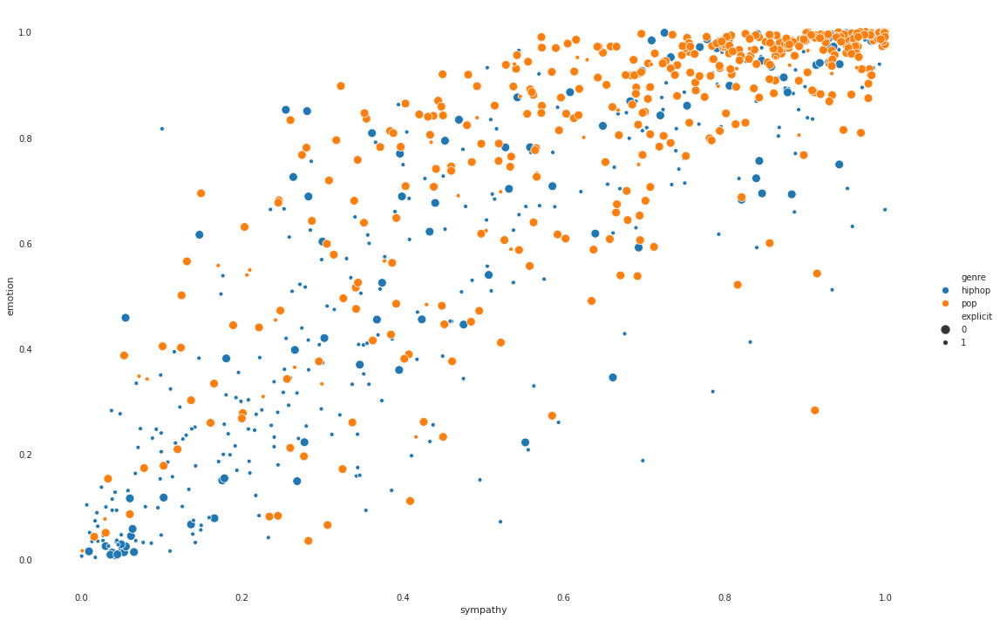

In [16]:
sns.relplot(x="sympathy", y="emotion", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_personality_sentiment)

**Below there is not an obbious linear relationship between emotion and modesty, despite us knowing there is a correlation. However, the points are gravitating to either corner. Also there are more blue points at the bottom left and more orange points at the top right. From this, I think that modesty and possible emotion will be good predictors of genre. Also the size of the points is similarly distributed. Earlier we already saw that explicit was possible a good predictor of genre.**

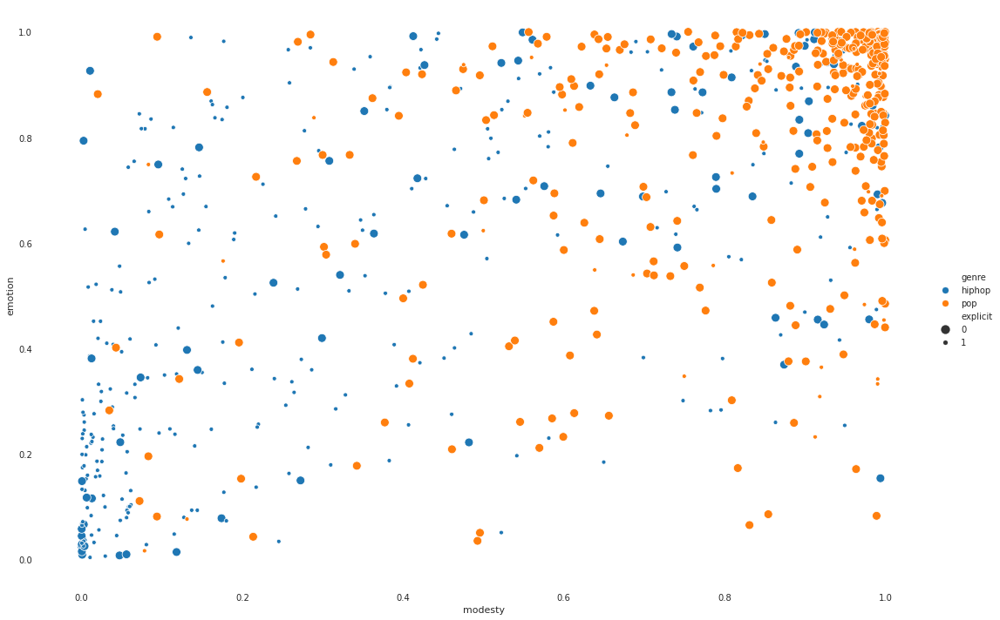

In [17]:
sns.relplot(x="modesty", y="emotion", hue = "genre", size = "explicit", 
             height = 10, aspect = 1.5, data = df_personality_sentiment)

**Sentiment is either negative or positive, and magnitude is the magnitude of that sentiment. There are slightly more orange points on the right and blue points on the left. It might not be enough to be a good predictor.**

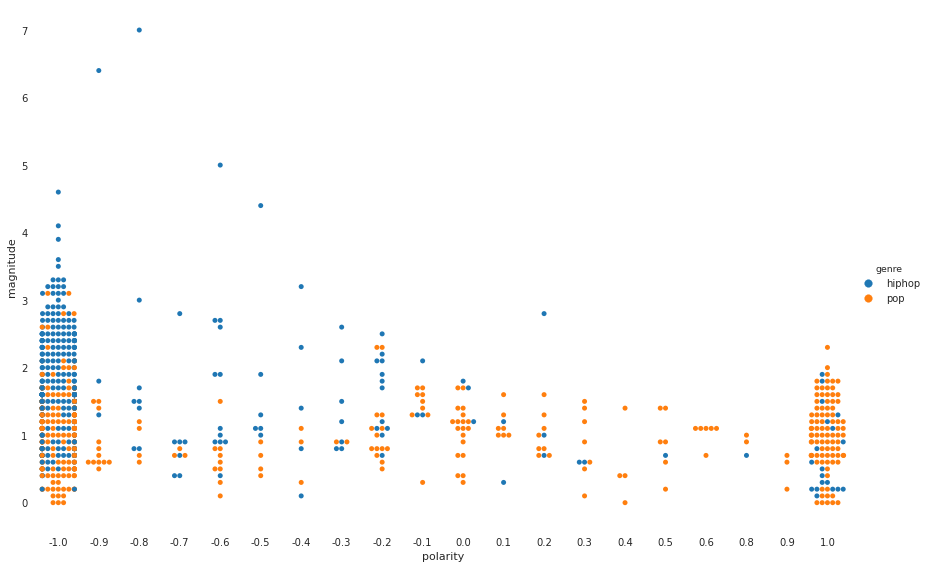

In [18]:
sns.catplot(x="polarity", y="magnitude", hue="genre", kind="swarm",
              height=8, aspect=1.5, data=df_personality_sentiment)

**Now I take a look at the inverse document frequency of bigrams and trigrams for hiphop songs and pop songs.**
**Thanks to Susan Li from Medium. I use the given english stop words, and four more words I saw occur frequently that maybe aren't good predictors.**

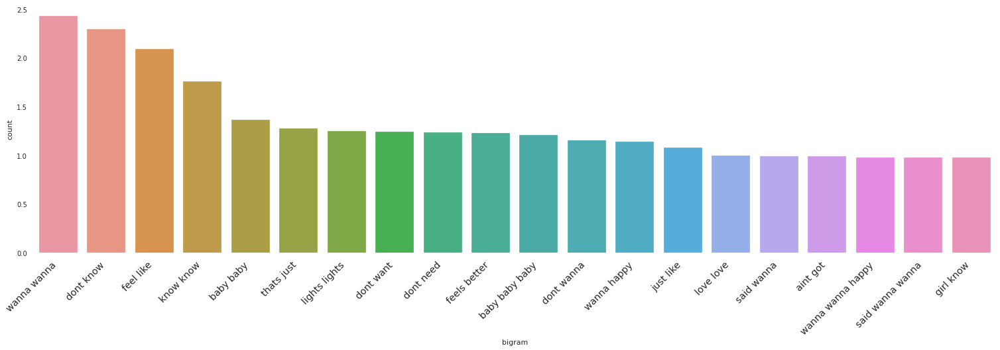

In [19]:
def get_top_n_words(corpus, n=None):
  my_stop_words = text.ENGLISH_STOP_WORDS.union(
      ["oh", "yeah", "im", "hey"])
  vec = TfidfVectorizer(
      ngram_range=(2, 3), stop_words=my_stop_words).fit(corpus)
  bag_of_words = vec.transform(corpus)
  sum_words = bag_of_words.sum(axis=0) 
  words_freq = [
          (word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
  return words_freq[:n]
common_words = get_top_n_words(
    df_personality_sentiment[
                    df_personality_sentiment["genre"]=="hiphop"]['lyrics'], 20)
df = pd.DataFrame(common_words, columns = ['bigram' , 'count'])
chart = sns.catplot(x="bigram", y="count", kind = "bar", 
            height = 6, aspect = 3.5,data=df)
chart.set_xticklabels(rotation=45, horizontalalignment='right', 
                      fontsize='x-large')

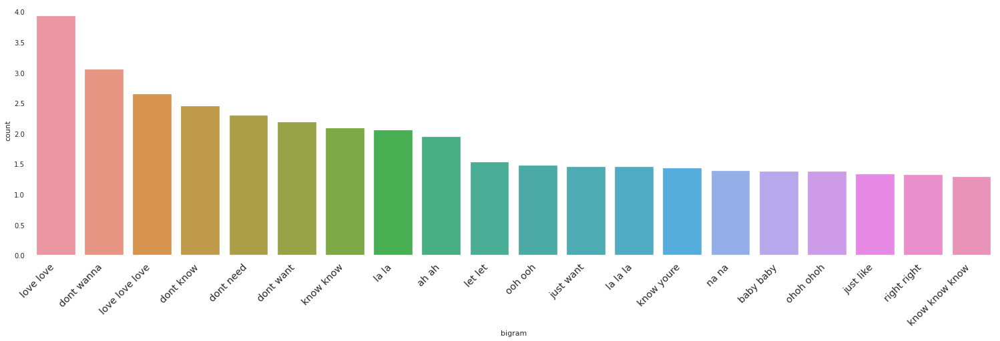

In [20]:
common_words = get_top_n_words(
    df_personality_sentiment[
                    df_personality_sentiment["genre"]=="pop"]['lyrics'], 20)
df = pd.DataFrame(common_words, columns = ['bigram' , 'count'])
chart = sns.catplot(x="bigram", y="count", kind = "bar", 
            height = 6, aspect = 3.5,data=df)
chart.set_xticklabels(rotation=45, horizontalalignment='right', 
                      fontsize='x-large')

# Machine Learning

**I will be choosing between Logistic Regression, KNeighbors Classifier, and Random Forest Classifier. I start out with just Logistic and KNeighbors because I haven't chosen features yet, and Random Forest won't work well on just one quantitative feature. I start off with just one random audio feature**

In [21]:
pipeline = make_pipeline(
    StandardScaler(),
    LogisticRegression()
)

X_train = df_songs[["danceability"]]
y_train = df_songs["genre"]

pipeline.fit(X_train, y_train)
y_train_ = pipeline.predict(X_train)
(f1_score(y_train, y_train_, pos_label="hiphop"), 
 f1_score(y_train, y_train_, pos_label="pop"))

(0.4046094750320103, 0.6463878326996197)

In [24]:
pipeline = make_pipeline(
    StandardScaler(),
    KNeighborsClassifier()
)

X_train = df_songs[["danceability"]]
y_train = df_songs["genre"]

pipeline.fit(X_train, y_train)
y_train_ = pipeline.predict(X_train)
(f1_score(y_train, y_train_, pos_label="hiphop"), 
 f1_score(y_train, y_train_, pos_label="pop"))

(0.6720160481444333, 0.7024567788899)

**KNeighbors does better than Logistic. I individually tested all the features and ended up with the ones below. I test different combinations of them. My scoring is by the f1 score.**

In [22]:
pop_f1 = []
hiphop_f1 = []
feature = []
for features in [["speechiness"],
                 ["speechiness", "duration_s", "energy"],
                 ["speechiness", "duration_s", "energy", "valence"],
                 ["speechiness", "duration_s", "energy", "valence", "liveness"],
                 ["speechiness", "duration_s", "energy", "valence", "tempo"],
                 ["speechiness", "duration_s", "energy", "liveness", 
                  "tempo", "valence"]]:
  ct = make_column_transformer(
      (StandardScaler(), features),
      remainder = "drop"
  )

  pipeline = make_pipeline(
      ct,
      KNeighborsClassifier()
  )

  X_train = df_songs[["energy", "liveness", "speechiness", "tempo", 
                      "valence", "duration_s", "explicit"]]
  y_train = df_songs["genre"]

  pipeline.fit(X_train, y_train)
  y_train_ = pipeline.predict(X_train)
  feature.append(features)
  hiphop_f1.append(f1_score(y_train, y_train_, pos_label="hiphop"))
  pop_f1.append(f1_score(y_train, y_train_, pos_label="pop"))

df = {}
df["feature"] = feature
df["pop"] = pop_f1
df["hiphop"] = hiphop_f1
df1 = pd.DataFrame(df)
df1["avg"] = (df1["pop"] + df1["hiphop"]) / 2
df1

,feature,pop,hiphop,avg
0,[speechiness],0.796460,0.761905,0.779182
1,"[speechiness, duration_s, energy]",0.813743,0.791919,0.802831
2,"[speechiness, duration_s, energy, valence]",0.825737,0.800409,0.813073
3,"[speechiness, duration_s, energy, valence, liv...",0.819469,0.788820,0.804144
4,"[speechiness, duration_s, energy, valence, tempo]",0.817621,0.784599,0.801110
5,"[speechiness, duration_s, energy, liveness, te...",0.817467,0.780231,0.798849


**So I choose speechiness, duration_s, and energy and valence. I want to estimate test error now instead of the training error. And now that I have features, I want to try RandomForest.**

In [23]:
pipeline = make_pipeline(
    StandardScaler(),
    RandomForestClassifier()
)

cv_errs = cross_val_score(pipeline,
             df_songs[["speechiness", "duration_s", "energy", "valence"]],
             df_songs["genre"], scoring="f1_macro", cv=10)

cv_errs.mean()

0.750511342748051

**Random Forest is better than KNeighbors for test error. Now I'm going to check models with textual features.**

In [27]:
f1 = []
feature = []
for features in [["modesty"],
                 ["emotion"],
                 ["assertive"],
                 ["modesty", "assertive"],
                 ["modesty", "emotion"],
                 ["modesty", "assertive", "emotion"],]:
  
  ct = make_column_transformer(
      (StandardScaler(), features),
      remainder = "drop"
  )

  pipeline = make_pipeline(
      ct,
      RandomForestClassifier(max_features = 'sqrt')
  )
  cv_errs = cross_val_score(pipeline,
              df_personality_sentiment[ ["emotion", "assertive", "modesty"]],
              df_personality_sentiment["genre"], scoring="f1_macro", cv=10)
  
  feature.append(features)
  f1.append(cv_errs.mean())

df = {}
df["feature"] = feature
df["f1"] = f1
df1 = pd.DataFrame(df)
df1

,feature,f1
0,[modesty],0.708254
1,[emotion],0.610225
2,[assertive],0.612830
3,"[modesty, assertive]",0.758275
4,"[modesty, emotion]",0.731521
5,"[modesty, assertive, emotion]",0.749223


**Modesty and assertive are the best. I add explicit now, which I decided to consider as a textual feature instead of audio features, and which I also thought would be a good predictor.**

In [28]:
f1 = []
feature = []
for features in [["modesty", "explicit"],
                 ["modesty", "assertive", "explicit"],
                 ["modesty", "assertive", "emotion", "explicit"]]:
  
  ct = make_column_transformer(
      (StandardScaler(), features),
      remainder = "drop"
  )

  pipeline = make_pipeline(
      ct,
      RandomForestClassifier(max_features = 'sqrt')
  )
  cv_errs = cross_val_score(pipeline,
              df_personality_sentiment[["emotion", "assertive", "modesty", 
                                        "explicit"]],
              df_personality_sentiment["genre"], scoring="f1_macro", cv=10)
  
  feature.append(features)
  f1.append(cv_errs.mean())

df = {}
df["feature"] = feature
df["f1"] = f1
df1 = pd.DataFrame(df)
df1

,feature,f1
0,"[modesty, explicit]",0.763685
1,"[modesty, assertive, explicit]",0.800500
2,"[modesty, assertive, emotion, explicit]",0.806271


**So my best audio features(0.751) lose to my best textual features(0.806). I will do hyperparameter tuning on just the textual features.**

In [29]:
pipeline = make_pipeline(
    StandardScaler(),
    RandomForestClassifier(max_features = 'sqrt')
)

n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)] + [None]
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4]
bootstrap = [True, False]
random_grid = {'randomforestclassifier__n_estimators': n_estimators,
               'randomforestclassifier__max_depth': max_depth,
               'randomforestclassifier__min_samples_split': min_samples_split,
               'randomforestclassifier__min_samples_leaf': min_samples_leaf,
               'randomforestclassifier__bootstrap': bootstrap}

rs = RandomizedSearchCV(
    pipeline, param_distributions = random_grid, n_iter = 100, 
    scoring="f1_macro", cv = 5)

model = rs.fit(
    df_personality_sentiment[["emotion", "assertive", "modesty", "explicit"]],
    df_personality_sentiment["genre"])

model.best_params_

{'randomforestclassifier__bootstrap': True,
 'randomforestclassifier__max_depth': 10,
 'randomforestclassifier__min_samples_leaf': 1,
 'randomforestclassifier__min_samples_split': 10,
 'randomforestclassifier__n_estimators': 100}

**So this is my best textual features model.**

In [30]:
pipeline = make_pipeline(
    StandardScaler(),
    RandomForestClassifier(max_features = 'sqrt', bootstrap=True, max_depth=10,
                           min_samples_leaf=1, min_samples_split=10,
                           n_estimators=100)
)
cv_errs = cross_val_score(pipeline,
            df_personality_sentiment[["emotion", "assertive", "modesty", 
                                      "explicit"]],
            df_personality_sentiment["genre"], scoring="f1_macro", cv=10)
cv_errs.mean()

0.8128944367583267

**Just to see, I use a model on just the lyrics, using the stopwords I used for my ngrams bar chart. I can't really combine this model with the textual features model, because of how many columns there will be after tranforming the lyrics column, and because my parameter for max_features is sqrt.**

In [33]:
my_stop_words = text.ENGLISH_STOP_WORDS.union(
      ["oh", "yeah", "im", "hey"])

pipeline = make_pipeline(
    TfidfVectorizer(stop_words=my_stop_words),
    RandomForestClassifier(max_features = 'sqrt')
)

cv_errs = cross_val_score(pipeline,
             df_personality_sentiment["lyrics"],
             df_personality_sentiment["genre"], scoring="f1_macro", cv=10)

cv_errs.mean()

0.8436935250201227

**It appears the lyric model beats both the audio features and textual features model. Below is the best lyric model after hyperparameter tuning.** 

In [38]:
pipeline = make_pipeline(
    TfidfVectorizer(stop_words=my_stop_words),
    RandomForestClassifier(max_features = 'sqrt', bootstrap=False, max_depth=70,
                           min_samples_leaf=2, min_samples_split=2,
                           n_estimators=100)
)
cv_errs = cross_val_score(pipeline,
            df_personality_sentiment["lyrics"],
            df_personality_sentiment["genre"], scoring="f1_macro", cv=10)
cv_errs.mean()

0.8466031382188326

**Whatever Stuff**

**Now just for fun I will generate random hiphop and pop lyrics using the markov_chain model from lab 4 and see how well my best model labels them.**

In [0]:
def train_markov_chain(lyrics):
    """
    Args:
      - lyrics: a list of strings, where each string represents
                the lyrics of one song by an artist.
    
    Returns:
      A dict that maps a single word ("unigram") to a list of
      words that follow that word, representing the Markov
      chain trained on the lyrics.
    """
    chain = {"<START>": []}
    for lyric in lyrics:
      lyric[:0] = ["<START>"] 
      lyric.append("<END>")
      lyric_bigrams = get_bigrams(lyric)
      for bigram in list(lyric_bigrams):
        if bigram[0] not in chain:
          chain[bigram[0]] = []
        chain[bigram[0]].append(bigram[1])
        # YOUR CODE HERE
        pass
        
    return chain

In [0]:
import random

def generate_new_lyrics(chain):

    words = []
    words.append(random.choice(chain["<START>"]))
    i = 0
    while words[i] != "<END>":
      words.append(random.choice(chain[words[i]]))
      i += 1

    lyrics = " ".join(words[:-1])
    return "\n".join(lyrics.split("<N>"))

**Generating 500 "hiphop songs" and 500 "pop songs".**

In [0]:
lyrics_test = []
for i in range(500):
  chain = train_markov_chain(
    df_personality_sentiment[df_personality_sentiment["genre"]=='hiphop'] \
                                  ["chain_lyrics"].str.split())
  hiphop_lyrics = generate_new_lyrics(chain)
  lyrics_test.append(hiphop_lyrics)

In [0]:
pipeline = make_pipeline(
    TfidfVectorizer(stop_words=my_stop_words),
    RandomForestClassifier(max_features = 'sqrt', bootstrap=False, max_depth=70,
                           min_samples_leaf=2, min_samples_split=2,
                           n_estimators=100)
)
pipeline.fit(df_personality_sentiment["lyrics"],
            df_personality_sentiment["genre"])
labels = pipeline.predict(lyrics_test)

In [76]:
list(labels).count("hiphop")/500

0.862

**The model has 86.2% recall for the generated "hiphop songs".**

In [0]:
lyrics_test = []
for i in range(500):
  chain = train_markov_chain(
    df_personality_sentiment[df_personality_sentiment["genre"]=='pop'] \
                                  ["chain_lyrics"].str.split())
  pop_lyrics = generate_new_lyrics(chain)
  lyrics_test.append(pop_lyrics)

In [0]:
pipeline = make_pipeline(
    TfidfVectorizer(stop_words=my_stop_words),
    RandomForestClassifier(max_features = 'sqrt', bootstrap=False, max_depth=70,
                           min_samples_leaf=2, min_samples_split=2,
                           n_estimators=100)
)
pipeline.fit(df_personality_sentiment["lyrics"],
            df_personality_sentiment["genre"])
labels = pipeline.predict(lyrics_test)

In [80]:
list(labels).count("pop")/500

0.962

**The model has 96.2% recall for generated "pop songs".**